# シミュレーション実行例（python）
* 大量にCPUとメモリを使う（メモリは16GB程度？）  
* i9-10850k使っても10秒のシミュレーションに1時間以上かかる

In [1]:
#%matplotlib nbagg
import matplotlib.pyplot as plt
#matplotlib.rcParams['animation.embed_limit'] = 2**128
from IPython.display import HTML
import numpy as np
import simulator

## 実行例

### 目標値，RMP制御器のパラメータをセット（しなくてもよい）  
* goal_param  
キーを目標点の対象のセクション番号，中身を位置ベクトル（一次元配列）で指定
* attractor_param  
アトラクターRMPのパラメータ
* jlavoidance_param  
ジョイント制限回避RMPのパラメータ

In [2]:
goal = {
    4:[0, 0, 0.6],
    2:[0.1, 0.1, 0.4]
}

### シミュレーターを実体化

In [3]:
sim = simulator.Simulator(N=5, goal_param=goal)

### シミュレーション実行

In [4]:
sim.run(TIME_SPAN=3)

シミュレーション実行中...
シミュレーション終了!
47.22082281112671 s in run


### アクチュエータベクトルq, q_dotの時刻歴から状態の時刻歴を再現  
* 凄く時間かかる  
* N=5, TIME_SPAN=10で1時間程度  

In [5]:
sim.reproduce_state()

  0%|          | 0/300 [00:00<?, ?it/s]

データ復元中...
q...
q_dot...
x...


100%|██████████| 300/300 [05:58<00:00,  1.19s/it]

358.09195590019226 s in reproduce_state


### データ保存
* すぐ終わる
* 目標値，制御パラメータはyamlファイル，微分方程式の解はcsvファイル

In [6]:
sim.save_data()

csvに保存中...
完了!
0.007671356201171875 s in save_data


### グラフ作成

plot完了!
0.4860515594482422 s in plot_basic


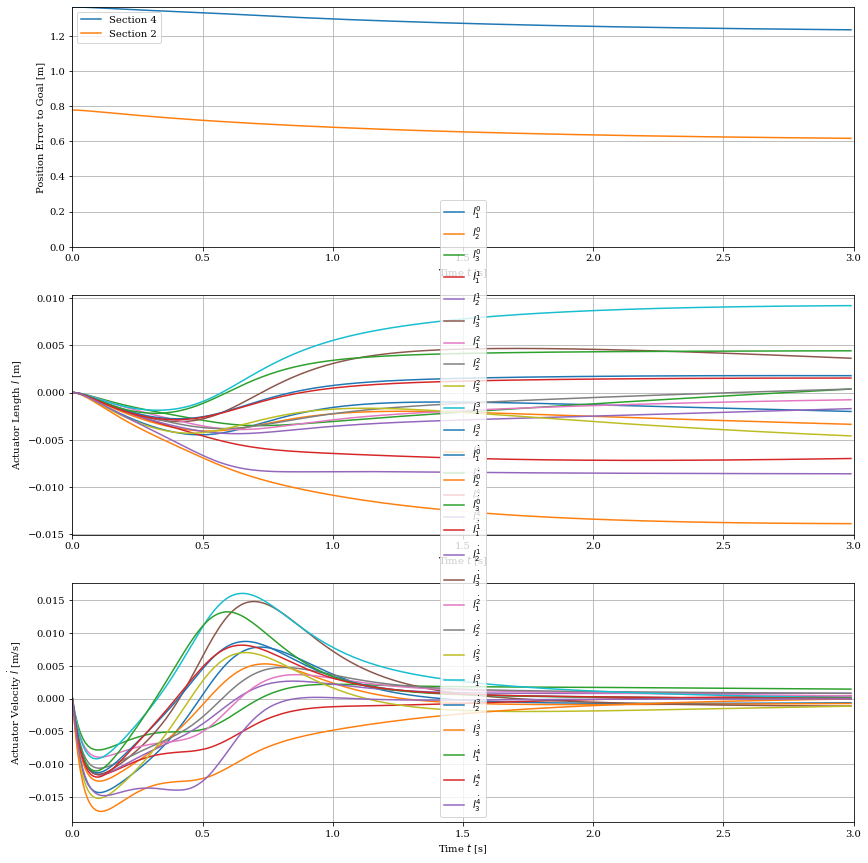

In [7]:
sim.plot_basic()

### アニメーション作成（凄く時間かかる）
* githubでは動かない  

アニメ作成中...
完了!


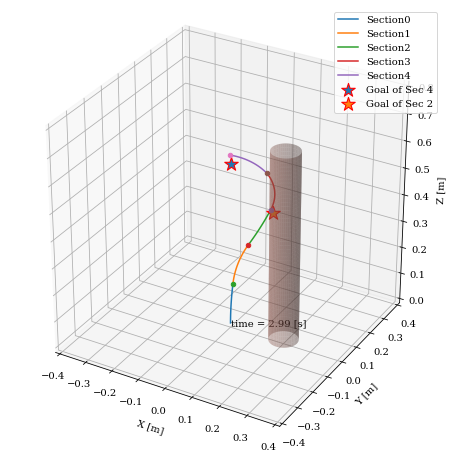

74.19895648956299 s in make_aniation


Animation size has reached 21076799 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [8]:
HTML(sim.make_aniation().to_jshtml())

### データの利用
下記のように格納されてる

* 微分方程式の解  
sim.sol

* q, q_dotの時刻歴  
sim.q, sim.q_dot

* 状態の時刻歴  
sim.x

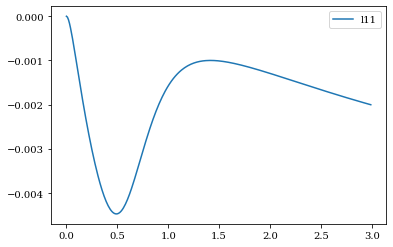

In [10]:
# セクション1つめのl1の時刻歴グラフの作成例
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(sim.sol.t, sim.sol.y[0], label="l11")
ax.legend()
plt.show()